<a href="https://colab.research.google.com/github/areegtarek/Fashion_MNIST_clothing_classification/blob/main/Fashion_MNIST_clothing_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Fashion MNIST  Clothing Classification**

Kaggle Link: https://www.kaggle.com/datasets/zalando-research/fashionmnist?select=fashion-mnist_train.csv

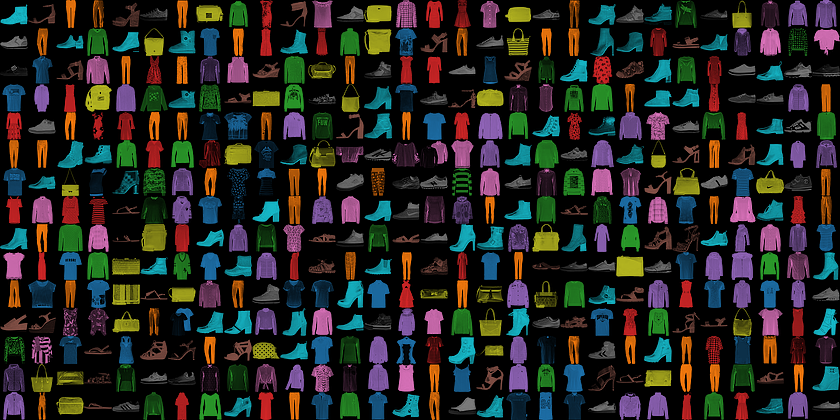

# **Data Description**

Each image is 28 pixels in height and 28 pixels in width, for a total of 784 pixels in total. Each pixel has a single pixel-value associated with it, indicating the lightness or darkness of that pixel, with higher numbers meaning darker. This pixel-value is an integer between 0 and 255. The training and test data sets have 785 columns. The first column consists of the class labels (see above), and represents the article of clothing. The rest of the columns contain the pixel-values of the associated image.

To locate a pixel on the image, suppose that we have decomposed x as x = i * 28 + j, where i and j are integers between 0 and 27. The pixel is located on row i and column j of a 28 x 28 matrix.
For example, pixel31 indicates the pixel that is in the fourth column from the left, and the second row from the top, as in the ascii-diagram below.

**Labels**

Each training and test example is assigned to one of the following labels:

- 0: T-shirt/top
- 1: Trouser
- 2: Pullover
- 3: Dress
- 4: Coat
- 5: Sandal
- 6: Shirt
- 7: Sneaker
- 8: Bag
- 9: Ankle boot

**TL;DR**

Each row is a separate image.

Column 1 is the class label.

Remaining columns are pixel numbers (784 total).

Each value is the darkness of the pixel (1 to 255)

#**Import libraries**

In [ ]:
#importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix
import os, time
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import applications
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import Dense, Dropout, Flatten , AveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.applications.vgg19 import preprocess_input
from tensorflow.keras import models
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras import callbacks
from tensorflow.keras.layers import LeakyReLU
import warnings
warnings.filterwarnings('ignore')
import keras # main keras package
from keras.models import Sequential # sequential model
from keras.layers import Dropout, Flatten, AveragePooling2D,MaxPool2D # layers with layers operations
from keras.layers import Dense,Conv2D  # layers types
from keras.layers import BatchNormalization

print("Keras version:", keras.__version__)

Keras version: 2.12.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#**Import Data**

In [ ]:
#import train file
df = pd.read_csv('/content/drive/MyDrive/Data Mining&DL/DL/The-Fashion-MNIST-clothing-classification-main/fashion-mnist_train.csv')
#import test file
df2 = pd.read_csv('/content/drive/MyDrive/Data Mining&DL/DL/The-Fashion-MNIST-clothing-classification-main/fashion-mnist_test.csv')

#**Data Exploration**

In [ ]:
#display number of rows & columns in train file
print("Fashion MNIST train -  rows:",df.shape[0]," columns:", df.shape[1])
#display number of rows & columns in test file
print("Fashion MNIST test -  rows:",df2.shape[0]," columns:", df2.shape[1])

Fashion MNIST train -  rows: 60000  columns: 785
Fashion MNIST test -  rows: 10000  columns: 785


In [ ]:
#display head of train file
df.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,0,0,0,5,0,...,0,0,0,30,43,0,0,0,0,0
3,0,0,0,0,1,2,0,0,0,0,...,3,0,0,0,0,1,0,0,0,0
4,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#display head of test file
df2.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,0,0,0,0,0,0,0,0,9,8,...,103,87,56,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,34,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,14,53,99,...,0,0,0,0,63,53,31,0,0,0
3,2,0,0,0,0,0,0,0,0,0,...,137,126,140,0,133,224,222,56,0,0
4,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#display some data info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 359.3 MB


In [ ]:
#display the type of data
df.dtypes.unique()

array([dtype('int64')], dtype=object)

**Observation:** Desired type of data here is int64 .


In [ ]:
#describe train file to know some statistical information about it
df.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,...,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.00000
mean,4.500000,0.000900,0.006150,0.035333,0.101933,0.247967,0.411467,0.805767,2.198283,5.682000,...,34.625400,23.300683,16.588267,17.869433,22.814817,17.911483,8.520633,2.753300,0.855517,0.07025
std,2.872305,0.094689,0.271011,1.222324,2.452871,4.306912,5.836188,8.215169,14.093378,23.819481,...,57.545242,48.854427,41.979611,43.966032,51.830477,45.149388,29.614859,17.397652,9.356960,2.12587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.00000


In [ ]:
#check missing values
df.isnull().sum().any()

False

**Observation:** We have no missing values in our data.

In [ ]:
#check duplicated data
df.duplicated().any()

True

In [ ]:
#display number of duplicated data
df.duplicated().sum()

43

**Observation:** We have 43 duplicated data points we should remove them.

In [ ]:
#remove duplicated data & check again
df.drop_duplicates(inplace=True)
df.duplicated().sum()

0

**Observation:** Now we have no duplicated data points.

#**Data Visualizations**

*Data Correlation*
---

In [ ]:
#plot correlation between columns
corr=df.corr()
corr.style.background_gradient(cmap='coolwarm')

<Axes: >

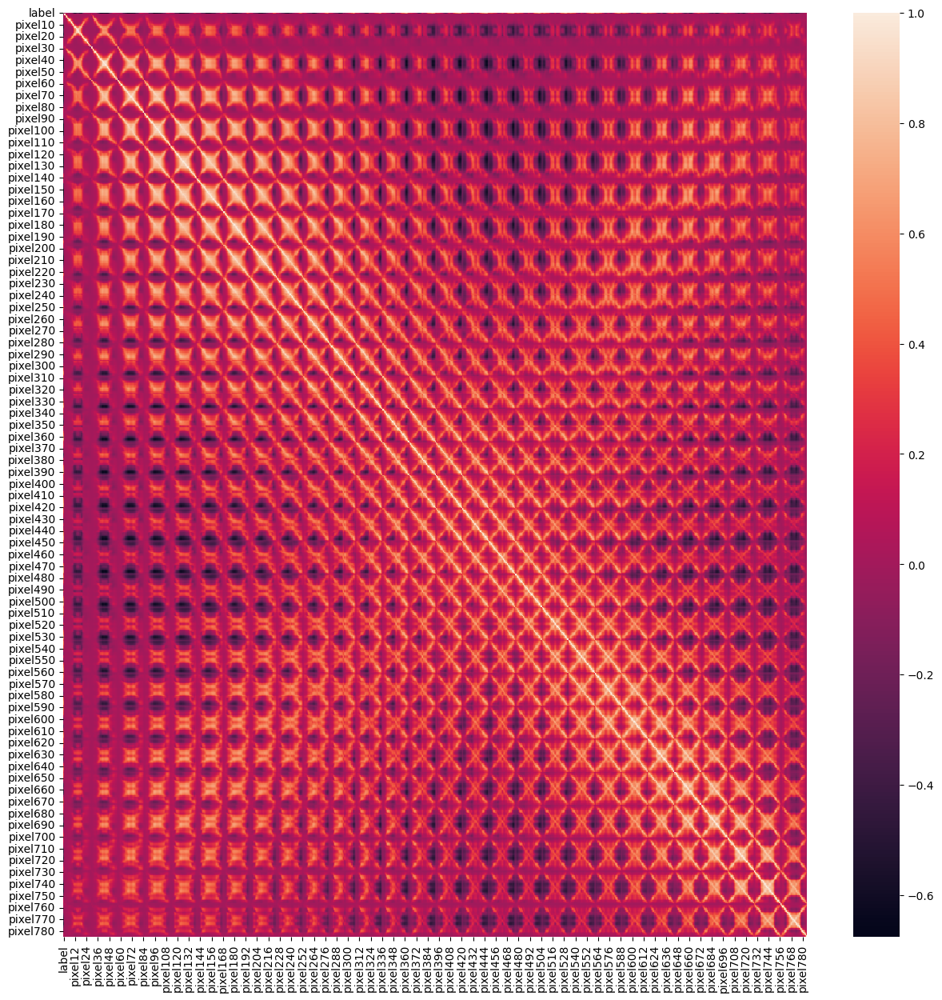

In [ ]:
#display the heatmap to represent correlation intensity
plt.figure(figsize=(15,15))
sns.heatmap(data=df.corr())

*Label for each class*
---

In [ ]:
#Frequency distribution of classes"
outcome = pd.crosstab(index=df["label"],  # Make a crosstab
                              columns="count")      # Name the count column
 
outcome

col_0,count
label,
0,5998
1,5996
2,5988
3,5997
4,5995
5,6000
6,5989
7,5996
8,6000


**Observation:** the classes are balanced

*Display Some Images*
---

In [ ]:
labels = {0 : "T-shirt/top", 1: "Trouser", 2: "Pullover", 3: "Dress", 4: "Coat",
          5: "Sandal", 6: "Shirt", 7: "Sneaker", 8: "Bag", 9: "Ankle Boot"}

In [ ]:
#function to display some images

def sample_images_data(data):
    # An empty list to collect some samples
    sample_images = []
    sample_labels = []

    # Iterate over the keys of the labels dictionary defined in the above cell
    for k in labels.keys():
        # Get four samples for each category
        samples = data[data["label"] == k].head(2)
        # Append the samples to the samples list
        for j, s in enumerate(samples.values):
            # First column contain labels, hence index should start from 1
            img = np.array(samples.iloc[j, 1:]).reshape(28,28)
            sample_images.append(img)
            sample_labels.append(samples.iloc[j, 0])

    print("Total number of sample images to plot: ", len(sample_images))
    return sample_images, sample_labels

train_sample_images, train_sample_labels = sample_images_data(df)

Total number of sample images to plot:  20


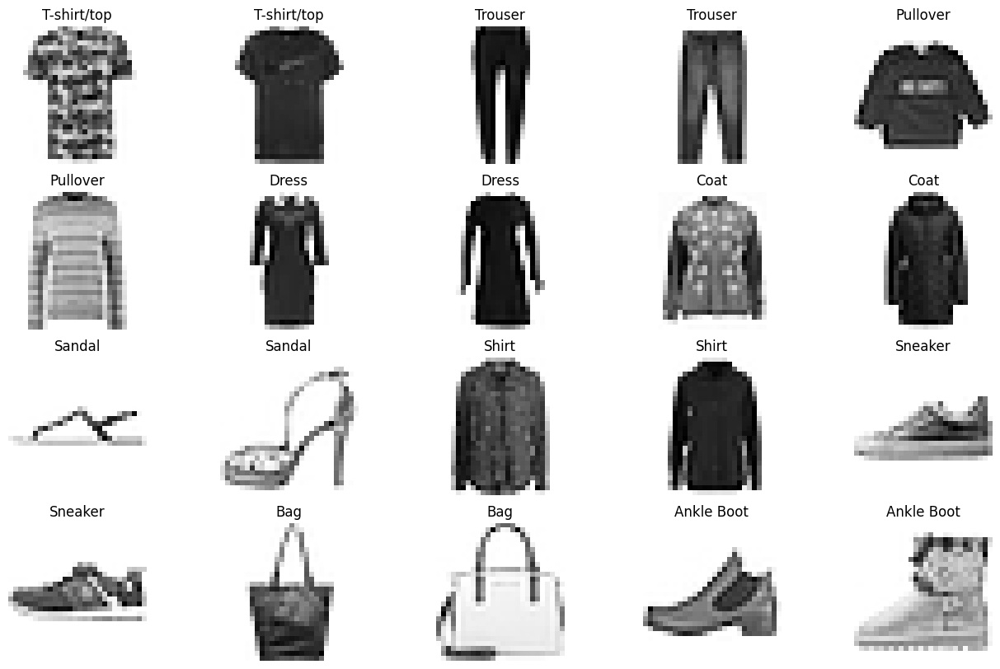

In [ ]:
def plot_sample_images(data_sample_images,data_sample_labels,cmap="Greys"):
    # Plot the sample images now
    f, ax = plt.subplots(4,5, figsize=(16,10))

    for i, img in enumerate(data_sample_images):
        ax[i//5, i%5].imshow(img, cmap=cmap)
        ax[i//5, i%5].axis('off')
        ax[i//5, i%5].set_title(labels[data_sample_labels[i]])
    plt.show()    

#display some train images
plot_sample_images(train_sample_images,train_sample_labels, "Greys")

Total number of sample images to plot:  20


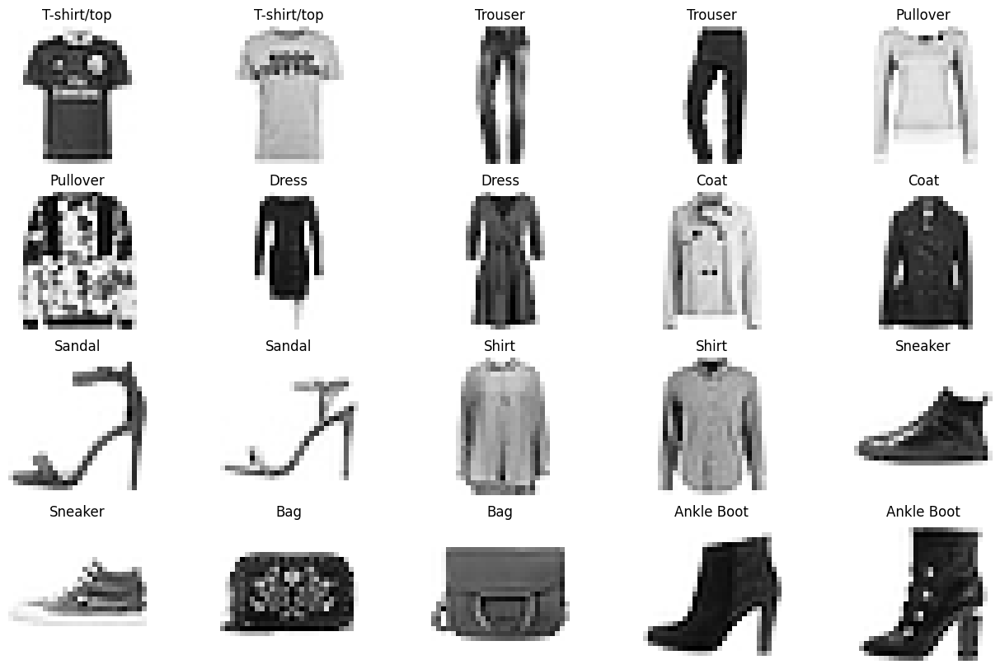

In [ ]:
#display some test images
test_sample_images, test_sample_labels = sample_images_data(df2)
plot_sample_images(test_sample_images,test_sample_labels,"Greys")

#**✔️ 1. LeNet-5 Model**

* Input: Flattened 784 px grayscale images, which can be represented as dimension (n, 28, 28, 1)
* Output: 0 - 9

##**Split Data**

- Splitting data to features (image pixels)(X) & labels column(y).

- Converting a class vector (integers) to binary class matrix.
      E.g. for use with categorical_crossentropy .

- Reshaping images: We have 28x28 pixels, black and white (1 channel only) pictures. Note that for a colored images we would have 3 channels (RGB). So the final shape will be (num_images, 28, 28, 1).

- Normalizing images by dividing each image by 255.


In [ ]:
# data preprocessing (reshape images and make normalization on them)
from keras.utils.np_utils import to_categorical

def data_preprocessing(data):
    y = to_categorical(data.label, 10)
    num_images = data.shape[0]
    x_as_array = data.values[:,1:]
    x_shaped_array = x_as_array.reshape(num_images, 28, 28, 1)
    X = x_shaped_array / 255
    return X, y

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# prepare the data
X, y = data_preprocessing(df)
X_test, y_test = data_preprocessing(df2)

In [ ]:
#shape of training data features
X.shape

(59957, 28, 28, 1)

In [ ]:
#shape of training data labels
y.shape

(59957, 10)

##**1.1) Defining the CNN architecture - LeNET:**

LeNet refers to LeNet-5 and is a simple convolutional neural network. LeNet-5 introduced convolutional and pooling layers. It is believed to be the base for all other ConvNets.

LeNet architecture does not contain dropouts or max pooling operations which are common in modern architectures.

A **max pooling** layer reduces the number of parameters in the layer by extracting the maximum value from a "patch" of a specified size (e.g. 2X2 pixels) and reducing layers size in such a way. There are also option to use the minimum value or the average one.

A **dropout** operation "kills" specified percentage of neurons (units) on a given layer to prevent overfitting. In order to prevent overfitting, you can also use a Batch Normalisation but it is not recommended to use dropouts and batch normalisation in a single model. This is so-called "disharmony" of dropout and batch normalization.

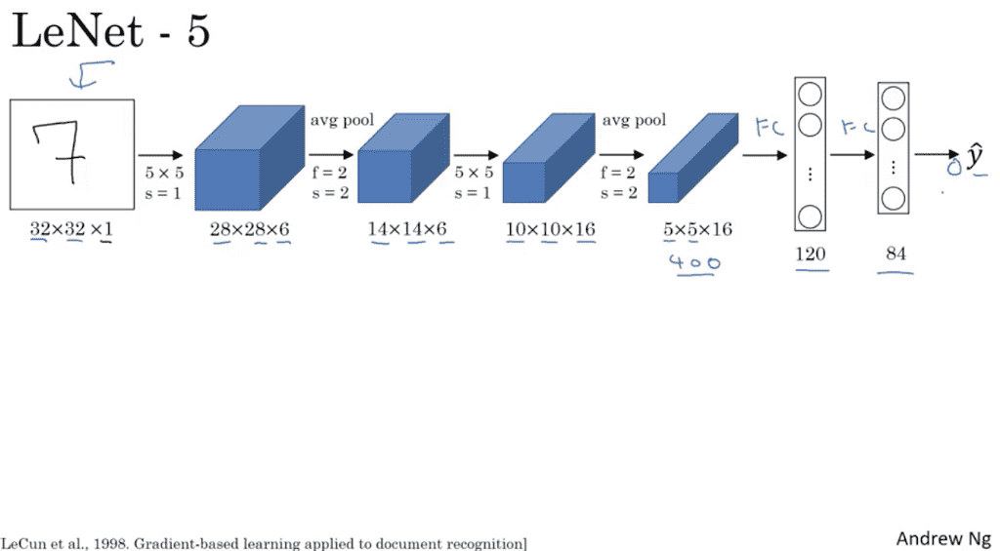

In [ ]:
model = Sequential([
    Conv2D(6, kernel_size=5, strides=1,  activation='tanh', input_shape=(28,28,1), padding='same'),
    AveragePooling2D(), 
    Conv2D(16, kernel_size=5, strides=1, activation='tanh', padding='valid'), 
    AveragePooling2D(), 
    Conv2D(120, kernel_size=5, strides=1, activation='tanh', padding='valid'), 
    Flatten(),    
    Dense(84, activation='tanh'), 
    Dense(10, activation='softmax') 
])

##**1.2) Summarising model**

It is worth to summarise the model to see how many trainable parameters our model contains - this has a direct impact on computational power required.

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 6)         156       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)                                                     
                                                                 
 conv2d_2 (Conv2D)           (None, 1, 1, 120)         48120     
                                                                 
 flatten (Flatten)           (None, 120)               0

##**1.3) Compiling model**

CNN model has now to be compiled. To do so we will use:

- ADAM (ADAptive Moment estimation) **optimiser** 

- **loss function** will be categorical_crossentropy 
  
- Metric will be accuracy


In [ ]:
model.compile(optimizer="adam",
              loss="categorical_crossentropy",
              metrics=["accuracy"])

##**1.4) Fitting model to training data**

**Configure Training & Validation (K-Fold) Properties**




In [ ]:
k = 5
cross_val = KFold(k, shuffle=True, random_state=10)
fold_count = 1

# For training epochs
epochs = 35

# For loss & acc plotting
histories = []

# For testing/evaluation acc scores
eval_scores = []

# For callbacks
es_callbacks = keras.callbacks.EarlyStopping(monitor="val_loss",
                                          mode="min",
                                          verbose=1,
                                          patience=4)


**Start Training and Validation**

In [ ]:
for train, validation in cross_val.split(X):
    print("="*80)
    print("Fold-{}".format(fold_count))
    print("-"*80)
    print("Training & Validation")
    fold_count = fold_count + 1
    
    # model = sequential_model(input_shape)
    
    X_train, y_train = X[train], y[train]
    X_val, y_val = X[validation], y[validation]
    
    history = model.fit(X_train, y_train,
                        epochs=epochs,
                        batch_size=521,
                        validation_data=(X_val, y_val),
                        callbacks=[es_callbacks])
    
    print("-"*80)
    print("Testing/evaluation")
    eval_loss, eval_accuracy = model.evaluate(X_test, y_test)
    
    histories.append(history)
    eval_scores.append(eval_accuracy)
    print("_"*80)

Fold-1
--------------------------------------------------------------------------------
Training & Validation
Epoch 1/35
93/93 [==============================] - 13s 13ms/step - loss: 0.9163 - accuracy: 0.6667 - val_loss: 0.6123 - val_accuracy: 0.7717
Epoch 2/35
93/93 [==============================] - 1s 7ms/step - loss: 0.5557 - accuracy: 0.7950 - val_loss: 0.5380 - val_accuracy: 0.7980
Epoch 3/35
93/93 [==============================] - 1s 7ms/step - loss: 0.4915 - accuracy: 0.8208 - val_loss: 0.4732 - val_accuracy: 0.8251
Epoch 4/35
93/93 [==============================] - 1s 8ms/step - loss: 0.4536 - accuracy: 0.8351 - val_loss: 0.4630 - val_accuracy: 0.8315
Epoch 5/35
93/93 [==============================] - 1s 7ms/step - loss: 0.4226 - accuracy: 0.8471 - val_loss: 0.4140 - val_accuracy: 0.8494
Epoch 6/35
93/93 [==============================] - 1s 9ms/step - loss: 0.4031 - accuracy: 0.8546 - val_loss: 0.4192 - val_accuracy: 0.8451
Epoch 7/35
93/93 [==============================

##**1.5) Tracking Learning**


**Visualizing loss and accuracy graphs from every fold.**

In [ ]:
def display_kfold_result(history, k=1):
    # Train & Val Loss
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    
    # Train & Val Accuracy
    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]
    
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.title("Loss")
    plt.plot(loss, label="Training")
    plt.plot(val_loss, label="Validation")
    plt.legend(loc="upper right")
    
    plt.subplot(1, 2, 2)
    plt.title("Accuracy")
    plt.plot(accuracy, label="Training")
    plt.plot(val_accuracy, label="Validation")
    plt.legend(loc="lower right")
    
    plt.suptitle("Fold-{}".format(k))
    plt.show()

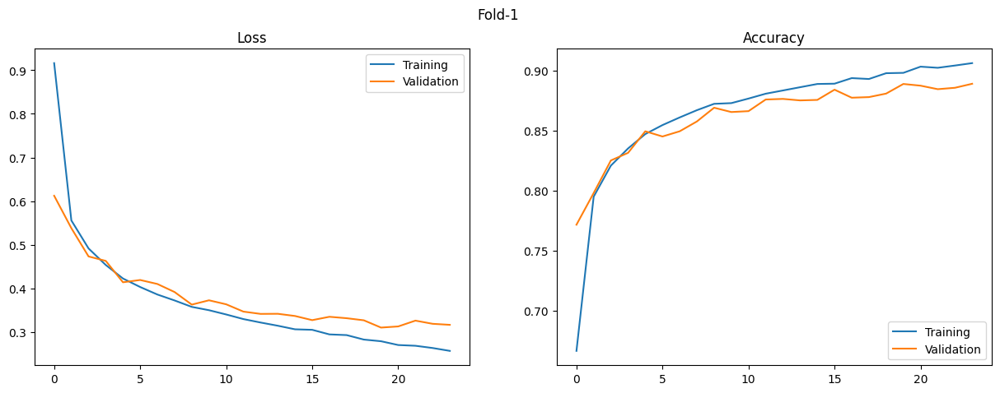

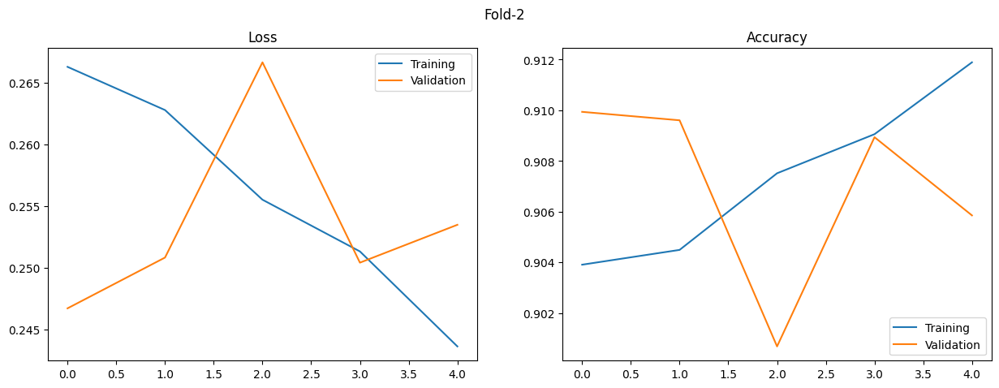

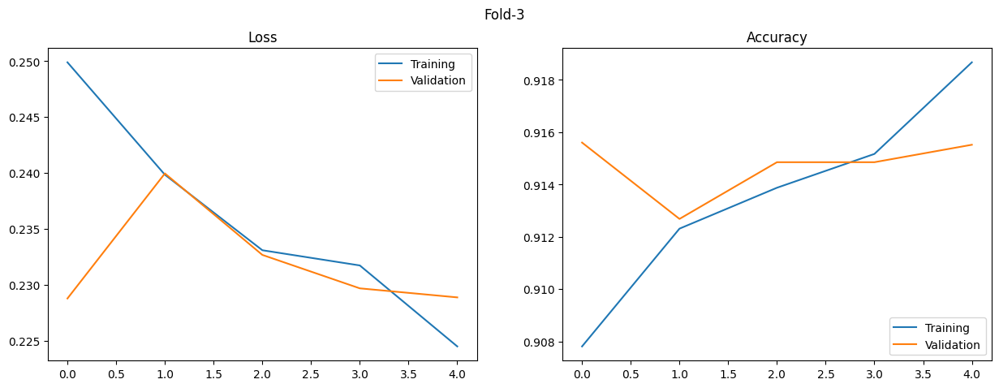

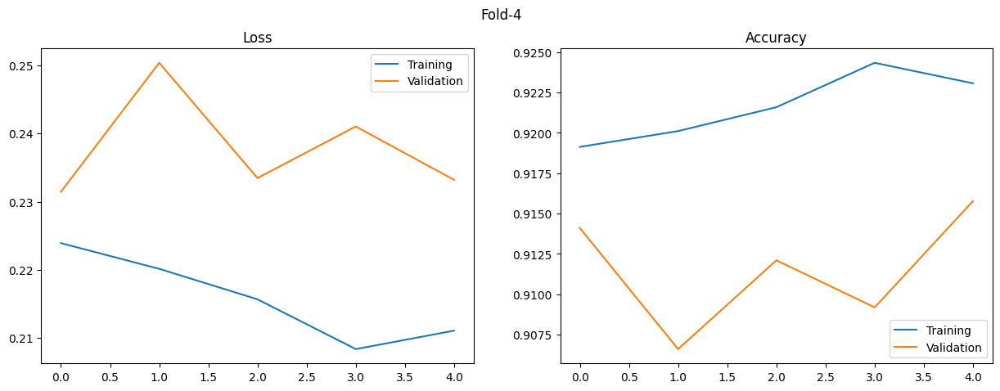

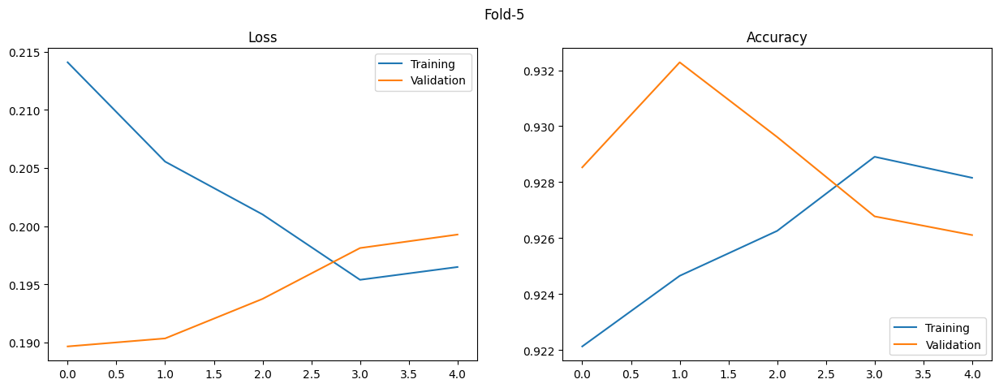

In [ ]:
# Displaying the graph results
for history in histories:
    display_kfold_result(history, (histories.index(history)+1))

##**Display Testing/Evaluation Accuracies**

In [ ]:
i = 0
float2 = "{0:.2f}"
for score in eval_scores:
    percent = score * 100
    print("Fold-{}: {}%".format(i+1, float2.format(percent)))
    i = i + 1

Fold-1: 88.76%
Fold-2: 89.10%
Fold-3: 89.84%
Fold-4: 89.93%
Fold-5: 90.02%


**Observation:** The best model instance was from fold-5.

#**✔️ LeNet-5 Model**

#**With some Adjustments on structure for Enhancement in model performance**

* Input: Flattened 784 px grayscale images, which can be represented as dimension (n, 28, 28, 1)
* Output: 0 - 9



##**Split Data**

- Splitting data to features (image pixels)(X) & labels column(y).

- Converting a class vector (integers) to binary class matrix.
      E.g. for use with categorical_crossentropy .

- Reshaping images: We have 28x28 pixels, black and white (1 channel only) pictures. Note that for a colored images we would have 3 channels (RGB). So the final shape will be (num_images, 28, 28, 1).

- Normalizing images by dividing each image by 255.


In [ ]:
# data preprocessing (reshape images and make normalization on them)
from keras.utils.np_utils import to_categorical

def data_preprocessing(data):
    y = to_categorical(data.label, 10)
    num_images = data.shape[0]
    x_as_array = data.values[:,1:]
    x_shaped_array = x_as_array.reshape(num_images, 28, 28, 1)
    X = x_shaped_array / 255
    return X, y

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# prepare the data
X, y = data_preprocessing(df)
X_test, y_test = data_preprocessing(df2)

In [ ]:
#shape of training data features
X.shape

(59957, 28, 28, 1)

In [ ]:
#shape of training data labels
y.shape

(59957, 10)

##**1.1) Defining the CNN architecture - LeNET:**

Adjustments on original structure:

1) activation function:'relu' instead of 'tanh'

2) diferent hidden units

3) max pooling layers instead of average pooling

In [ ]:
num_classes = 10

model = Sequential()
model.add(Conv2D(filters=32, kernel_size=(5,5), padding='same', activation='relu', input_shape=(28, 28, 1)))
model.add(MaxPool2D(strides=2))
model.add(Conv2D(filters=48, kernel_size=(5,5), padding='valid', activation='relu'))
model.add(MaxPool2D(strides=2))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(84, activation='relu'))
model.add(Dense(10, activation='softmax'))

##**1.2) Summarising model**

It is worth to summarise the model to see how many trainable parameters our model contains - this has a direct impact on computational power required.

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 28, 28, 32)        832       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 32)       0         
 )                                                               
                                                                 
 conv2d_4 (Conv2D)           (None, 10, 10, 48)        38448     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 48)         0         
 2D)                                                             
                                                                 
 flatten_1 (Flatten)         (None, 1200)              0         
                                                                 
 dense_2 (Dense)             (None, 256)              

##**1.3) Compiling model**

CNN model has now to be compiled. To do so we will use:

- ADAM (ADAptive Moment estimation) **optimiser** 

- My **loss function** will be categorical_crossentropy 
  
- Metric will be accuracy


In [ ]:
model.compile(optimizer="adam",
              loss="categorical_crossentropy",
              metrics=["accuracy"])

##**1.4) Fitting model to training data**


**Configure Training & Validation (K-Fold) Properties**




In [ ]:
k = 5
cross_val = KFold(k, shuffle=True, random_state=10)
fold_count = 1

# For training epochs
epochs = 35

# For loss & acc plotting
histories = []

# For testing/evaluation acc scores
eval_scores = []

# For callbacks
es_callbacks = keras.callbacks.EarlyStopping(monitor="val_loss",
                                          mode="min",
                                          verbose=1,
                                          patience=4)


**Start Training and Validation**

In [ ]:
for train, validation in cross_val.split(X):
    print("="*80)
    print("Fold-{}".format(fold_count))
    print("-"*80)
    print("Training & Validation")
    fold_count = fold_count + 1
    
    # model = sequential_model(input_shape)
    
    X_train, y_train = X[train], y[train]
    X_val, y_val = X[validation], y[validation]
    
    history = model.fit(X_train, y_train,
                        epochs=epochs,
                        batch_size=521,
                        validation_data=(X_val, y_val),
                        callbacks=[es_callbacks])
    
    print("-"*80)
    print("Testing/evaluation")
    eval_loss, eval_accuracy = model.evaluate(X_test, y_test)
    
    histories.append(history)
    eval_scores.append(eval_accuracy)
    print("_"*80)

Fold-1
--------------------------------------------------------------------------------
Training & Validation
Epoch 1/35
93/93 [==============================] - 4s 15ms/step - loss: 0.8429 - accuracy: 0.6987 - val_loss: 0.5907 - val_accuracy: 0.7827
Epoch 2/35
93/93 [==============================] - 1s 12ms/step - loss: 0.4836 - accuracy: 0.8234 - val_loss: 0.4773 - val_accuracy: 0.8256
Epoch 3/35
93/93 [==============================] - 1s 12ms/step - loss: 0.3922 - accuracy: 0.8615 - val_loss: 0.4295 - val_accuracy: 0.8447
Epoch 4/35
93/93 [==============================] - 1s 12ms/step - loss: 0.3523 - accuracy: 0.8749 - val_loss: 0.3970 - val_accuracy: 0.8543
Epoch 5/35
93/93 [==============================] - 1s 11ms/step - loss: 0.3232 - accuracy: 0.8850 - val_loss: 0.3726 - val_accuracy: 0.8608
Epoch 6/35
93/93 [==============================] - 1s 12ms/step - loss: 0.3033 - accuracy: 0.8919 - val_loss: 0.3374 - val_accuracy: 0.8742
Epoch 7/35
93/93 [==========================

##**1.5) Tracking Learning**



**Visualizing loss and accuracy graphs from every fold.**

In [ ]:
def display_kfold_result(history, k=1):
    # Train & Val Loss
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    
    # Train & Val Accuracy
    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]
    
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.title("Loss")
    plt.plot(loss, label="Training")
    plt.plot(val_loss, label="Validation")
    plt.legend(loc="upper right")
    
    plt.subplot(1, 2, 2)
    plt.title("Accuracy")
    plt.plot(accuracy, label="Training")
    plt.plot(val_accuracy, label="Validation")
    plt.legend(loc="lower right")
    
    plt.suptitle("Fold-{}".format(k))
    plt.show()

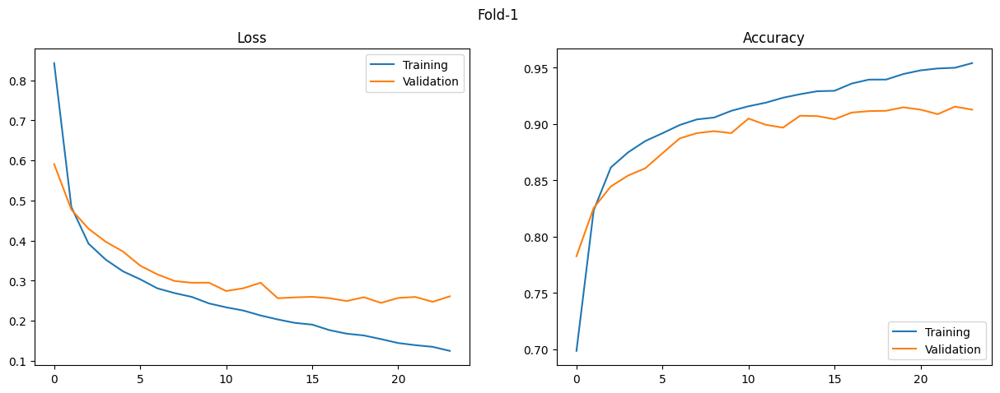

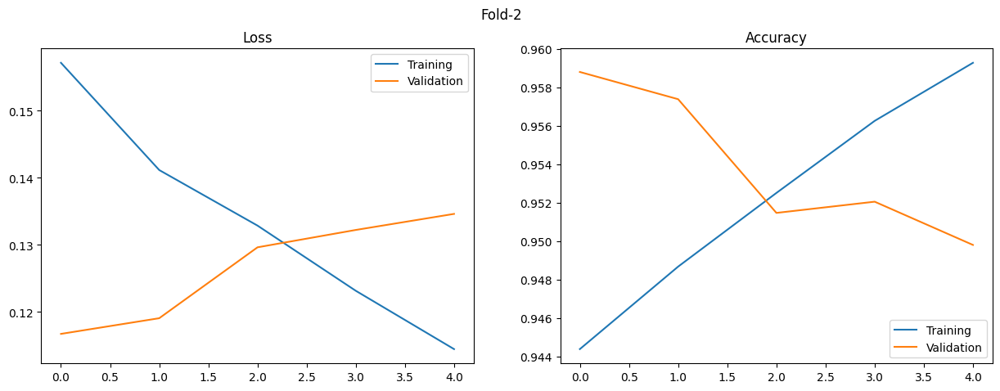

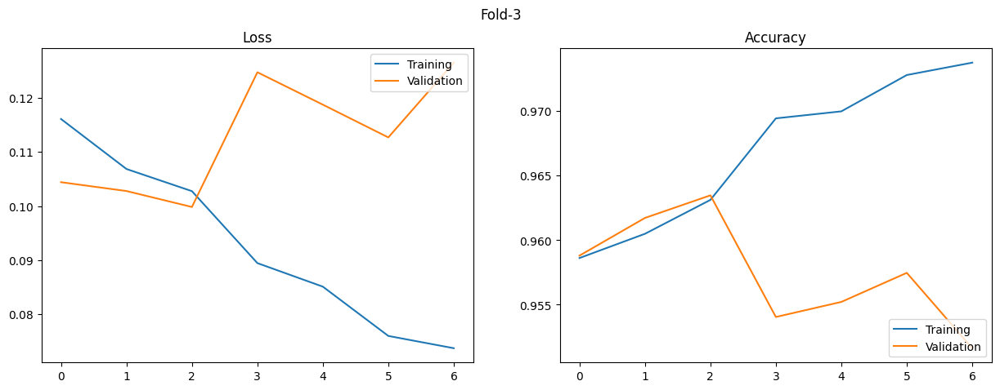

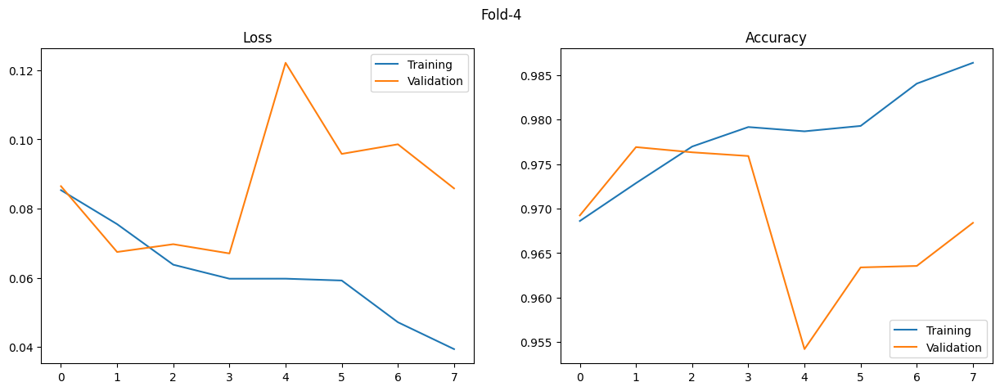

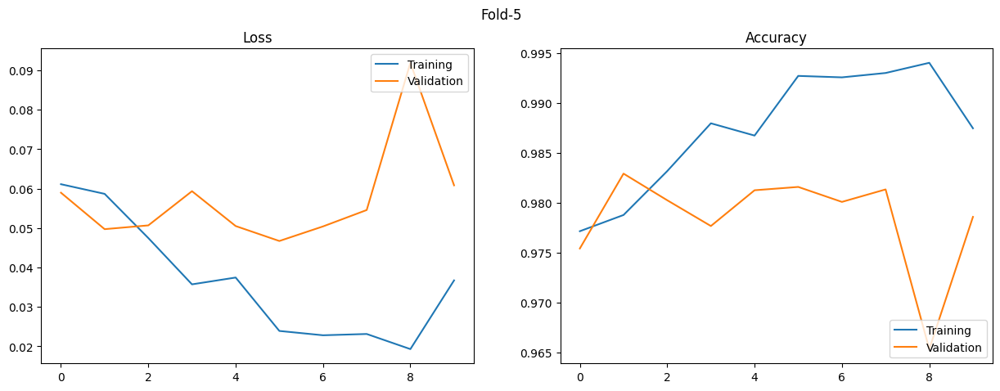

In [ ]:
# Displaying the graph results
for history in histories:
    display_kfold_result(history, (histories.index(history)+1))

##**Display Testing/Evaluation Accuracies**

In [ ]:
i = 0
float2 = "{0:.2f}"
for score in eval_scores:
    percent = score * 100
    print("Fold-{}: {}%".format(i+1, float2.format(percent)))
    i = i + 1

Fold-1: 91.37%
Fold-2: 91.90%
Fold-3: 91.51%
Fold-4: 92.19%
Fold-5: 92.22%


**Observation:** The best model instance was from fold-3.

#**✔️ 2. VGG19 Model**

* Input: Flattened 784 px grayscale images, which can be represented as dimension (n, 48, 48, 3)
* Output: 0 - 9

##**Load Data** 

In [ ]:
#take copy from train & test files
df_vgg =df.copy()
df2_vgg =df2.copy()

##**Split Data**

In [ ]:
#split train & test data to features and labels
x_train_vgg= np.array(df_vgg.iloc[:,1:])
y_train_vgg= np.array (df_vgg.iloc[:,0]) 

x_test_vgg= np.array(df2_vgg.iloc[:,1:])
y_test_vgg = np.array(df2_vgg.iloc[:,0]) 


##**Preprocessing**

*Unique values in target variable*

In [ ]:
classes = np.unique(y_train_vgg)
num_classes = len(classes)
num_classes

10

*Convert the images into 3 channels*

In [ ]:
x_train_vgg=np.dstack([x_train_vgg] * 3)
x_test_vgg=np.dstack([x_test_vgg]*3)

#shape after converting to 3 channels
x_train_vgg.shape,x_test_vgg.shape

((59957, 784, 3), (10000, 784, 3))

*Reshape images as per the tensor format required by tensorflow*

In [ ]:
x_train_vgg = x_train_vgg.reshape(-1, 28,28,3)
x_test_vgg= x_test_vgg.reshape (-1,28,28,3)

x_train_vgg.shape,x_test_vgg.shape

((59957, 28, 28, 3), (10000, 28, 28, 3))

*Resize the images (48,48) as required by VGG19*

In [ ]:
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
x_train_vgg = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in x_train_vgg])
x_test_vgg = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in x_test_vgg])

#shape after converting to size(48,48)
x_train_vgg.shape, x_test_vgg.shape

((59957, 48, 48, 3), (10000, 48, 48, 3))

*Normalise the data and change data type*

In [ ]:
x_train_vgg = x_train_vgg / 255.
x_test_vgg = x_test_vgg / 255.
x_train_vgg = x_train_vgg.astype('float32')
x_test_vgg = x_test_vgg.astype('float32')

*Converting Labels to one hot encoded format*

In [ ]:
y_train_vgg_one_hot = to_categorical(y_train_vgg)
y_test_vgg_one_hot = to_categorical(y_test_vgg)

In [ ]:
y_test_vgg_one_hot

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 0., 0.]], dtype=float32)

*Define the parameters for instanitaing VGG19 model*

In [ ]:
IMG_WIDTH = 48
IMG_HEIGHT = 48
IMG_DEPTH = 3
BATCH_SIZE = 16

*Preprocessing the input*

In [ ]:
x_train_vgg = preprocess_input(x_train_vgg)
x_test_vgg  = preprocess_input (x_test_vgg)

##**2.1) Defining the CNN architecture - VGG19:**

VGG19 is a variant of VGG model which in short consists of 19 layers (16 convolution layers, 3 Fully connected layer, 5 MaxPool layers and 1 SoftMax layer).

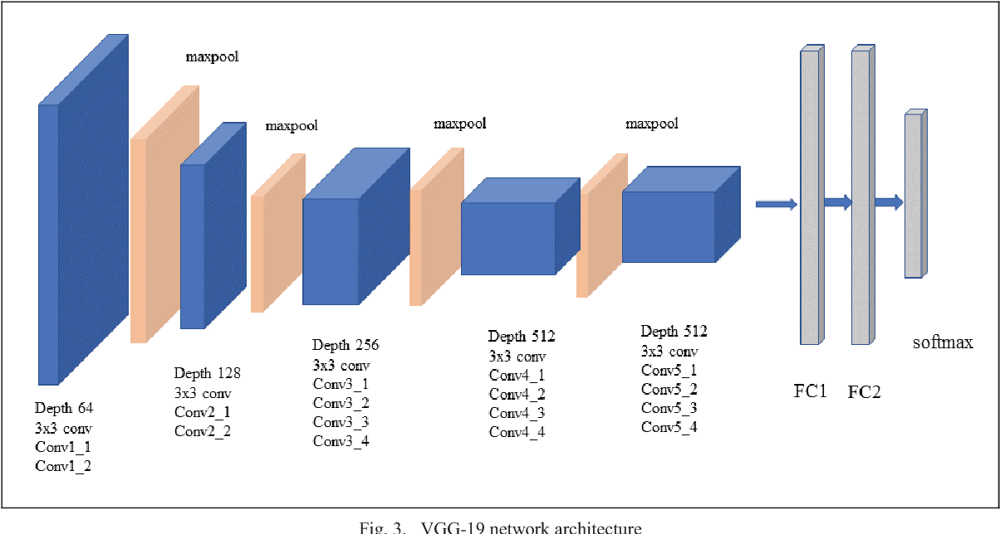

###**2.1.1) Create base model of VGG19**


we will take the mmodel but with freezing the top 3 dense layers and adding another densely connected classifier instead.

In [ ]:
conv_base = VGG19(weights="imagenet",
                  include_top=False, 
                  input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH)
                 )
conv_base.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

*Extracting features* 

In [ ]:
train_features = conv_base.predict(np.array(x_train_vgg), batch_size=BATCH_SIZE, verbose=1)
test_features = conv_base.predict(np.array(x_test_vgg), batch_size=BATCH_SIZE, verbose=1)

625/625 [==============================] - 5s 9ms/step


*Saving the features so that they can be used for future*

In [ ]:
np.savez("train_features", train_features, y_train_vgg_one_hot)
np.savez("test_features", test_features, y_test_vgg_one_hot)

*Current shape of features*

In [ ]:
print(train_features.shape, "\n",  test_features.shape)

(59957, 1, 1, 512) 
 (10000, 1, 1, 512)


*Flatten extracted features*

In [ ]:
train_features_flat = np.reshape(train_features, (59957, 1*1*512))
test_features_flat = np.reshape(test_features, (10000, 1*1*512))

### **2.1.2) Define the densely connected classifier**
We define the densely connected classifier followed by Batch Normalization layer followed by another dense layer then leakyrelu layer followed by another dense layer and Batch Normalization layer and finally dense layer for the number of classes

In [ ]:
NB_TRAIN_SAMPLES = train_features_flat.shape[0]

model = models.Sequential()
model.add(layers.Dense(512, activation='relu', input_dim=(1*1*512)))
model.add(layers.BatchNormalization())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.LeakyReLU(alpha=0.1))
model.add(layers.Dense(128, activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Dense(10, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               262656    
                                                                 
 batch_normalization (BatchN  (None, 512)              2048      
 ormalization)                                                   
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 batch_normalization_1 (Batc  (None, 128)              512       
 hNormalization)                                        

## **2.2) Compile the model**

In [ ]:
model.compile(
    loss='categorical_crossentropy',
    optimizer="Adam",
    #optimizer=tf.keras.optimizers.Adam(learning_rate=2e-5),
    metrics=['accuracy'])

##**2.3) Fitting model to training data**


**Configure Training & Validation (K-Fold) Properties**

In [ ]:
from keras.callbacks import ReduceLROnPlateau 
from tensorflow.keras.callbacks import ReduceLROnPlateau,EarlyStopping
seed=7
k = 5
cross_val = KFold(k, shuffle=True,random_state=seed)
fold_count = 1

# For training epochs
epochs = 35

# For loss & acc plotting
histories = []

# For testing/evaluation acc scores
eval_scores = []

# For callbacks
reduce_learning = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=2,
    verbose=1,
    mode='auto',
    cooldown=2,
    min_lr=0)

eary_stopping = EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=7,
    verbose=1,
    mode='auto')

es_callbacks = [reduce_learning, eary_stopping]
                                          

**Start Training and Validation**

In [ ]:
for train, validation in cross_val.split(train_features_flat):
    print("="*80)
    print("Fold-{}".format(fold_count))
    print("-"*80)
    print("Training & Validation")
    fold_count = fold_count + 1
    
    # model = sequential_model(input_shape)
    
    X_train, y_train = train_features_flat[train], y_train_vgg_one_hot[train]
    X_val, y_val = train_features_flat[validation], y_train_vgg_one_hot[validation]
    
    history = model.fit(X_train, y_train,
                        epochs=epochs,
                        batch_size=256,
                        validation_data=(X_val, y_val),
                        callbacks=[es_callbacks])
    
    print("-"*80)
    print("Testing/evaluation")
    eval_loss, eval_accuracy = model.evaluate(test_features_flat, y_test_vgg_one_hot)
    
    histories.append(history)
    eval_scores.append(eval_accuracy)
    print("_"*80)

Fold-1
--------------------------------------------------------------------------------
Training & Validation
Epoch 1/35
188/188 [==============================] - 5s 8ms/step - loss: 0.6910 - accuracy: 0.7551 - val_loss: 6.8387 - val_accuracy: 0.1117 - lr: 0.0010
Epoch 2/35
188/188 [==============================] - 1s 6ms/step - loss: 0.5482 - accuracy: 0.8004 - val_loss: 4.0547 - val_accuracy: 0.1085 - lr: 0.0010
Epoch 3/35
188/188 [==============================] - 1s 6ms/step - loss: 0.5110 - accuracy: 0.8124 - val_loss: 17.3672 - val_accuracy: 0.0994 - lr: 0.0010
Epoch 4/35
185/188 [============================>.] - ETA: 0s - loss: 0.4832 - accuracy: 0.8226
Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00020000000949949026.
188/188 [==============================] - 1s 7ms/step - loss: 0.4832 - accuracy: 0.8226 - val_loss: 8.9689 - val_accuracy: 0.2653 - lr: 0.0010
Epoch 5/35
188/188 [==============================] - 2s 9ms/step - loss: 0.4383 - accuracy: 0.8385 - val_l

##**2.4) Tracking Learning**


**Visualizing loss and accuracy graphs from every fold.**

In [ ]:
def display_kfold_result(history, k=1):
    # Train & Val Loss
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    
    # Train & Val Accuracy
    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]
    
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.title("Loss")
    plt.plot(loss, label="Training")
    plt.plot(val_loss, label="Validation")
    plt.legend(loc="upper right")
    
    plt.subplot(1, 2, 2)
    plt.title("Accuracy")
    plt.plot(accuracy, label="Training")
    plt.plot(val_accuracy, label="Validation")
    plt.legend(loc="lower right")
    
    plt.suptitle("Fold-{}".format(k))
    plt.show()

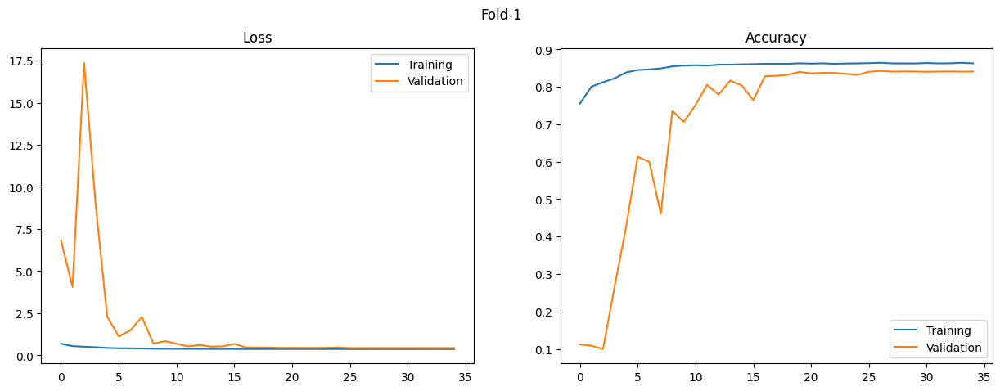

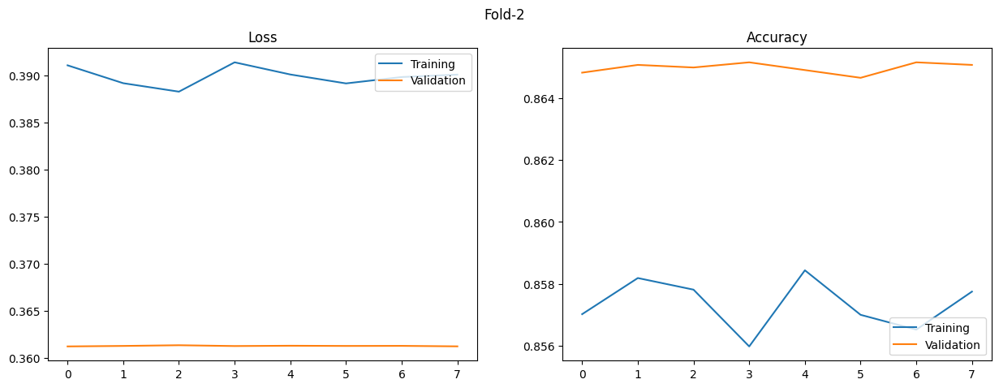

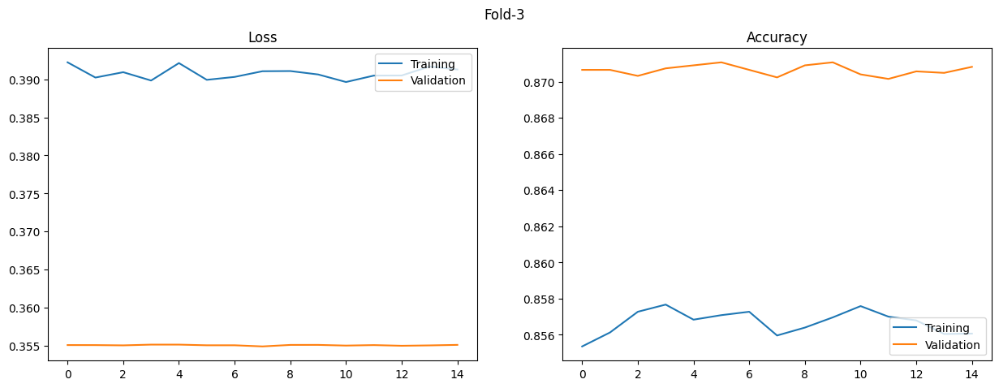

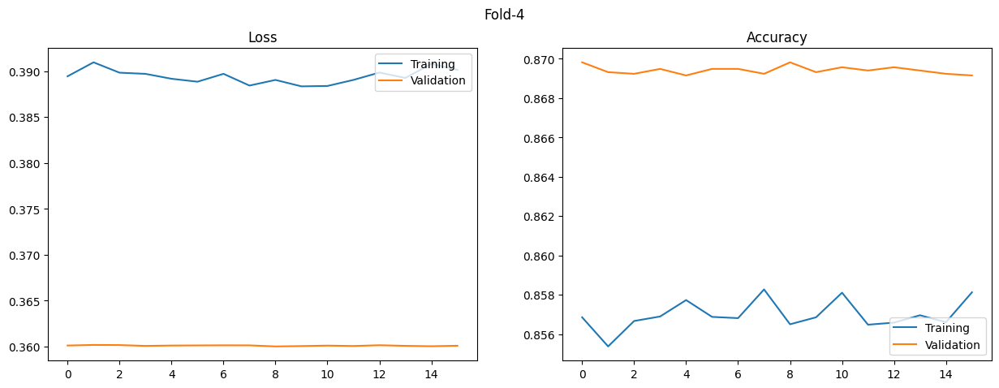

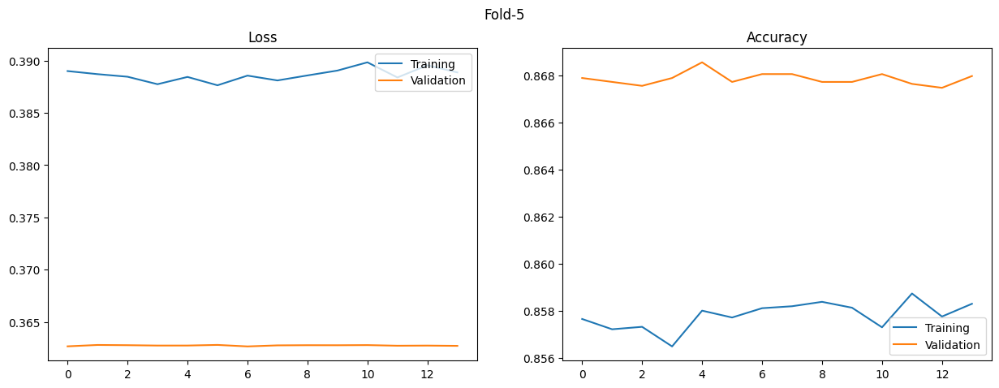

In [ ]:
# Displaying the graph results
for history in histories:
    display_kfold_result(history, (histories.index(history)+1))

##**Display Testing/Evaluation Accuracies**

In [ ]:
i = 0
float2 = "{0:.2f}"
for score in eval_scores:
    percent = score * 100
    print("Fold-{}: {}%".format(i+1, float2.format(percent)))
    i = i + 1

Fold-1: 84.43%
Fold-2: 84.45%
Fold-3: 84.43%
Fold-4: 84.41%
Fold-5: 84.37%


**Observation:** The best model instance was from fold-1.

In [ ]:
import tensorflow as tf
tf.keras.backend.clear_session()

#**✔️ 3. AlexNet Model**

* Input: Flattened 784 px grayscale images, which can be represented as dimension (n, 28, 28, 1)
* Output: 0 - 9

##**Load Data**

In [ ]:
#take copy from train & test files
df_alex =df.copy()
df2_alex =df2.copy()

##**Split Data**

- Change the data type to float.
- split data to features and labels.
- normalize data by dividing by 255.
- convert image shape

change the data type to float

In [ ]:
df_alex= np.array(df_alex, dtype= 'float32')
df2_alex= np.array(df2_alex, dtype= 'float32')

split & normalize data

In [ ]:
x_train_alex = df_alex[:,1:]/255
y_train_alex = df_alex[:,0]

x_test_alex = df2_alex[:,1:]/255
y_test_alex =df2_alex[:,0]

convert image shape to (n,28,28,1)

In [ ]:
#define the image shape
IMG_HEIGHT = 28
IMG_WIDTH = 28
BATCH_SIZE = 4096
image_shape = (IMG_HEIGHT,IMG_WIDTH,1) 

In [ ]:
#convert the shape
x_train_alex= x_train_alex.reshape(x_train_alex.shape[0], *image_shape)
x_test_alex = x_test_alex.reshape(x_test_alex.shape[0],*image_shape)

#display shape after converting 
x_train_alex.shape, x_test_alex.shape

((59957, 28, 28, 1), (10000, 28, 28, 1))

##**3.1) Defining the CNN architecture - AlexNet:**

The Alexnet has eight layers with learnable parameters. The model consists of five layers with a combination of max pooling followed by 3 fully connected layers and they use Relu activation in each of these layers except the output layer.

They found out that using the relu as an activation function accelerated the speed of the training process by almost six times. They also used the dropout layers, that prevented their model from overfitting. Further, the model is trained on the Imagenet dataset. The Imagenet dataset has almost 14 million images across a thousand classes.


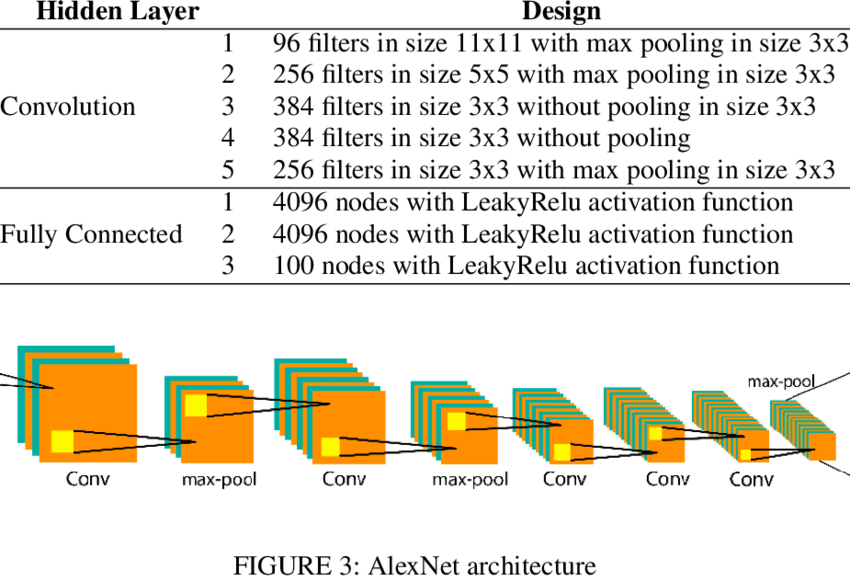

In [ ]:
# Alexnet
model= tf.keras.Sequential([Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation= 'relu', input_shape= image_shape),
                                      BatchNormalization(),
                                      MaxPooling2D(pool_size=(3,3), strides=(2,2), padding='same'),
                                      Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding='same'),
                                      BatchNormalization(),
                                      MaxPooling2D(pool_size=(3,3), strides=(2,2), padding='same'),
                                      Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding='same'),
                                      BatchNormalization(),
                                      Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding='same'),
                                      BatchNormalization(),
                                      Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding='same'),
                                      BatchNormalization(),
                                      MaxPooling2D(pool_size=(3,3), strides=(2,2), padding='same'),
                                      Flatten(),
                                      Dense(4096, activation='relu'),
                                      Dropout(0.5),
                                      Dense(4096, activation='relu'),
                                      Dropout(0.5),
                                      Dense(10, activation='softmax')
                                      ])

##**3.2) Summarising model**

It is worth to summarise the model to see how many trainable parameters our model contains - this has a direct impact on computational power required.

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 5, 5, 96)          11712     
                                                                 
 batch_normalization (BatchN  (None, 5, 5, 96)         384       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 3, 3, 96)         0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 3, 3, 256)         614656    
                                                                 
 batch_normalization_1 (Batc  (None, 3, 3, 256)        1024      
 hNormalization)                                                 
                                                        

##**3.3) Compiling model**

CNN model has now to be compiled. To do so we will use:

- SGD **optimiser** 

- My **loss function** will be sparse_categorical_crossentropy
  
- Metric will be accuracy


In [ ]:
# Model compilation and initialisation of optimizer
sgd = tf.keras.optimizers.SGD(learning_rate=0.01,momentum=0.9, nesterov=True)
model.compile(loss="sparse_categorical_crossentropy", optimizer=sgd, metrics=["accuracy"])

##**3.4) Fitting model to training data**

**Configure Training & Validation (K-Fold) Properties**


In [ ]:
k = 5
cross_val = KFold(k, shuffle=True, random_state=10)
fold_count = 1

# For training epochs
epochs = 15

# For loss & acc plotting
histories = []

# For testing/evaluation acc scores
eval_scores = []

# For callbacks
early_stopping_cb = keras.callbacks.EarlyStopping(monitor='val_loss', patience=30, verbose=1, mode='min')


**Start Training and Validation**

In [ ]:
for train, validation in cross_val.split(x_train_alex):
    print("="*80)
    print("Fold-{}".format(fold_count))
    print("-"*80)
    print("Training & Validation")
    fold_count = fold_count + 1
    
    # model = sequential_model(input_shape)
    
    X_train, y_train = x_train_alex[train], y_train_alex[train]
    X_val, y_val = x_train_alex[validation], y_train_alex[validation]
    
    history = model.fit(X_train, y_train,
                        epochs=epochs,
                        batch_size=512,
                        validation_data=(X_val, y_val),
                        callbacks=early_stopping_cb)
    
    print("-"*80)
    print("Testing/evaluation")
    eval_loss, eval_accuracy = model.evaluate(x_test_alex, y_test_alex)
    
    histories.append(history)
    eval_scores.append(eval_accuracy)
    print("_"*80)

Fold-1
--------------------------------------------------------------------------------
Training & Validation
Epoch 1/15
94/94 [==============================] - 12s 69ms/step - loss: 0.6495 - accuracy: 0.7629 - val_loss: 2.3722 - val_accuracy: 0.0985
Epoch 2/15
94/94 [==============================] - 4s 45ms/step - loss: 0.3779 - accuracy: 0.8621 - val_loss: 2.4081 - val_accuracy: 0.1970
Epoch 3/15
94/94 [==============================] - 4s 47ms/step - loss: 0.3244 - accuracy: 0.8815 - val_loss: 1.6704 - val_accuracy: 0.4119
Epoch 4/15
94/94 [==============================] - 4s 47ms/step - loss: 0.2932 - accuracy: 0.8913 - val_loss: 0.6650 - val_accuracy: 0.7751
Epoch 5/15
94/94 [==============================] - 4s 45ms/step - loss: 0.2722 - accuracy: 0.8995 - val_loss: 0.4345 - val_accuracy: 0.8406
Epoch 6/15
94/94 [==============================] - 4s 44ms/step - loss: 0.2509 - accuracy: 0.9069 - val_loss: 0.3548 - val_accuracy: 0.8664
Epoch 7/15
94/94 [=========================

**Tracking Learning**


**Visualizing loss and accuracy graphs from every fold.**

In [ ]:
def display_kfold_result(history, k=1):
    # Train & Val Loss
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    
    # Train & Val Accuracy
    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]
    
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.title("Loss")
    plt.plot(loss, label="Training")
    plt.plot(val_loss, label="Validation")
    plt.legend(loc="upper right")
    
    plt.subplot(1, 2, 2)
    plt.title("Accuracy")
    plt.plot(accuracy, label="Training")
    plt.plot(val_accuracy, label="Validation")
    plt.legend(loc="lower right")
    
    plt.suptitle("Fold-{}".format(k))
    plt.show()

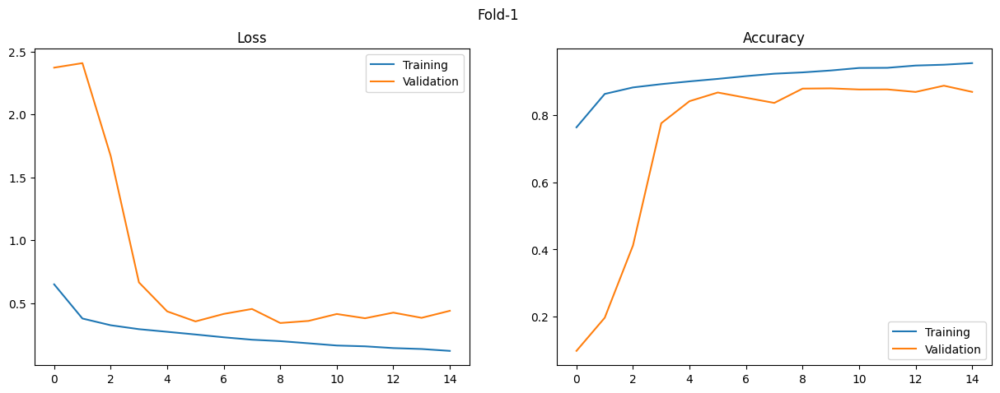

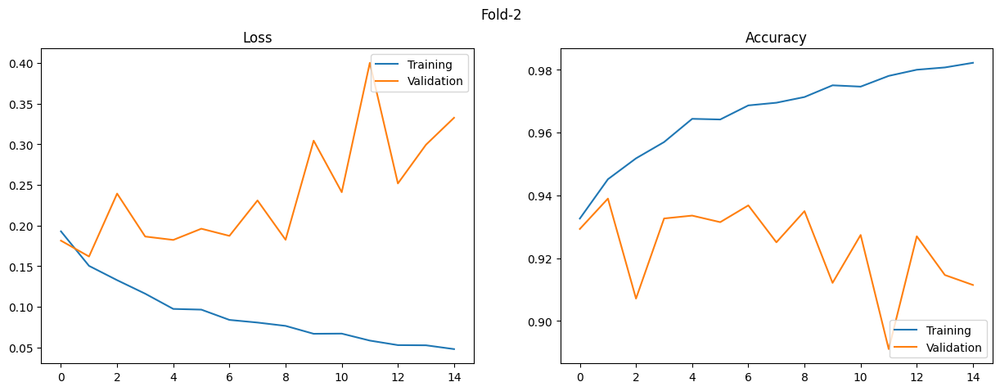

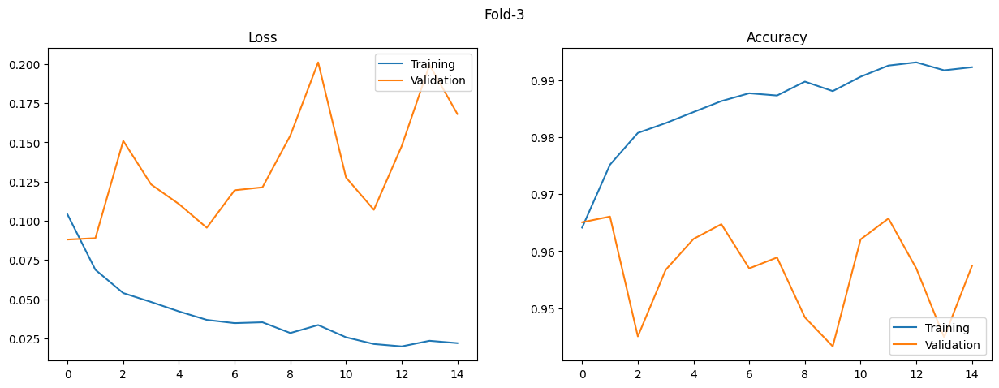

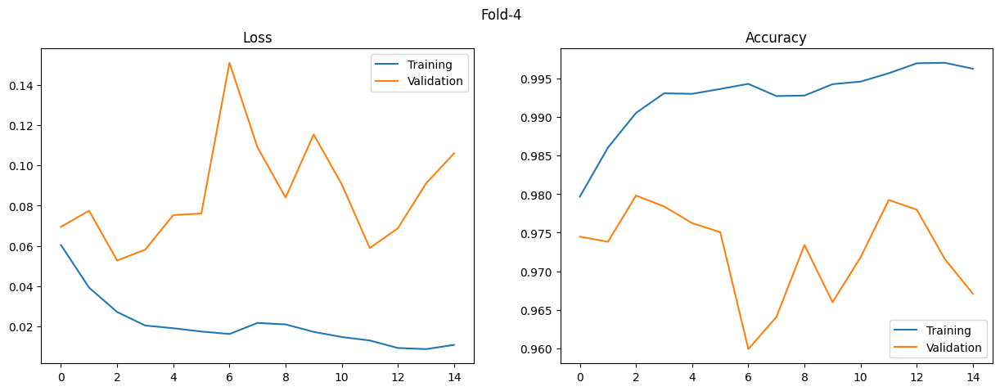

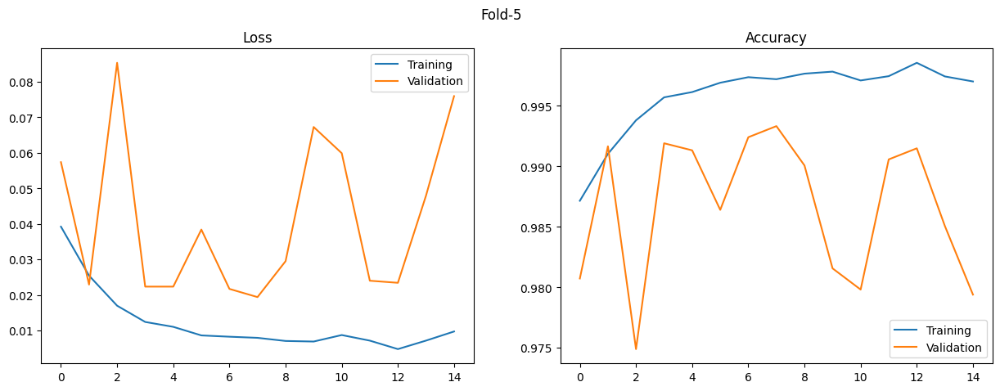

In [ ]:
# Displaying the graph results
for history in histories:
    display_kfold_result(history, (histories.index(history)+1))

##**Display Testing/Evaluation Accuracies**

In [ ]:
i = 0
float2 = "{0:.2f}"
for score in eval_scores:
    percent = score * 100
    print("Fold-{}: {}%".format(i+1, float2.format(percent)))
    i = i + 1

Fold-1: 87.19%
Fold-2: 88.55%
Fold-3: 89.79%
Fold-4: 89.54%
Fold-5: 89.26%


**Observation:** The best model instance was from fold-4.

